In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

from supervised.automl import AutoML

%matplotlib inline

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


### Dataset

In [2]:
data = pd.read_csv('../../data/productivity+prediction+of+garment+employees.csv')
target_variable = 'actual_productivity'
print(data.shape)
data.head()

(1197, 15)


,date,quarter,department,day,team,targeted_productivity,smv,wip,over_time,incentive,idle_time,idle_men,no_of_style_change,no_of_workers,actual_productivity
0,1/1/2015,Quarter1,sweing,Thursday,8,0.80,26.16,1108.0,7080,98,0.0,0,0,59.0,0.940725
1,1/1/2015,Quarter1,finishing,Thursday,1,0.75,3.94,NaN,960,0,0.0,0,0,8.0,0.886500
2,1/1/2015,Quarter1,sweing,Thursday,11,0.80,11.41,968.0,3660,50,0.0,0,0,30.5,0.800570
3,1/1/2015,Quarter1,sweing,Thursday,12,0.80,11.41,968.0,3660,50,0.0,0,0,30.5,0.800570
4,1/1/2015,Quarter1,sweing,Thursday,6,0.80,25.90,1170.0,1920,50,0.0,0,0,56.0,0.800382


In [3]:
data.info();

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1197 entries, 0 to 1196
Data columns (total 15 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   date                   1197 non-null   object 
 1   quarter                1197 non-null   object 
 2   department             1197 non-null   object 
 3   day                    1197 non-null   object 
 4   team                   1197 non-null   int64  
 5   targeted_productivity  1197 non-null   float64
 6   smv                    1197 non-null   float64
 7   wip                    691 non-null    float64
 8   over_time              1197 non-null   int64  
 9   incentive              1197 non-null   int64  
 10  idle_time              1197 non-null   float64
 11  idle_men               1197 non-null   int64  
 12  no_of_style_change     1197 non-null   int64  
 13  no_of_workers          1197 non-null   float64
 14  actual_productivity    1197 non-null   float64
dtypes: f

In [4]:
# add hours to the date tiem field
data['date'] = pd.to_datetime(data['date'], format='%m/%d/%Y')
# data['year'] = data['date'].dt.year # not relevant as we are only dealing with a year's worth of data
data['Month'] = data['date'].dt.month
data['day_of_week'] = data['date'].dt.day_of_week
data['day_of_month'] = data['date'].dt.day
cols_to_convert = ['over_time', 'incentive']
data[cols_to_convert] = data[cols_to_convert].astype('float')
data[['team', 'department', 'quarter', 'day', 'day_of_week']] = data[['team', 'department', 'quarter', 'day', 'day_of_week']].astype('category')

In [5]:
# date					:	Date in MM-DD-YYYY
# day					:   Day of the Week
# quarter				:	A portion of the month. A month was divided into four quarters
# department			:	Associated department with the instance
# team_no				:	Associated team number with the instance
# no_of_workers			:	Number of workers in each team
# no_of_style_change	:	Number of changes in the style of a particular product
# targeted_productivity	:	Targeted productivity set by the Authority for each team for each day.
# smv					:	Standard Minute Value, it is the allocated time for a task
# wip					:	Work in progress. Includes the number of unfinished items for products
# over_time				:	Represents the amount of overtime by each team in minutes
# incentive				:	Represents the amount of financial incentive (in BDT) that enables or motivates a particular course of action.
# idle_time				:	The amount of time when the production was interrupted due to several reasons
# idle_men				:	The number of workers who were idle due to production interruption
# actual_productivity	:	The actual % of productivity that was delivered by the workers. It ranges from 0-1.

data['wip'] = data['wip'].fillna(0)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1197 entries, 0 to 1196
Data columns (total 18 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   date                   1197 non-null   datetime64[ns]
 1   quarter                1197 non-null   category      
 2   department             1197 non-null   category      
 3   day                    1197 non-null   category      
 4   team                   1197 non-null   category      
 5   targeted_productivity  1197 non-null   float64       
 6   smv                    1197 non-null   float64       
 7   wip                    1197 non-null   float64       
 8   over_time              1197 non-null   float64       
 9   incentive              1197 non-null   float64       
 10  idle_time              1197 non-null   float64       
 11  idle_men               1197 non-null   int64         
 12  no_of_style_change     1197 non-null   int64         
 13  no_

In [6]:
# found some padding in the department feature
data.department = data.department.str.strip()
data.department.value_counts()

department
sweing       691
finishing    506
Name: count, dtype: int64

### Some manual visualization

In [7]:
data.describe()

,date,targeted_productivity,smv,wip,over_time,incentive,idle_time,idle_men,no_of_style_change,no_of_workers,actual_productivity,Month,day_of_month
count,1197,1197.000000,1197.000000,1197.000000,1197.000000,1197.000000,1197.000000,1197.000000,1197.000000,1197.000000,1197.000000,1197.000000,1197.000000
mean,2015-02-04 10:56:50.526315776,0.729632,15.062172,687.228070,4567.460317,38.210526,0.730159,0.369256,0.150376,34.609858,0.735091,1.724311,13.533835
min,2015-01-01 00:00:00,0.070000,2.900000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.233705,1.000000,1.000000
25%,2015-01-18 00:00:00,0.700000,3.940000,0.000000,1440.000000,0.000000,0.000000,0.000000,0.000000,9.000000,0.650307,1.000000,6.000000
50%,2015-02-03 00:00:00,0.750000,15.260000,586.000000,3960.000000,0.000000,0.000000,0.000000,0.000000,34.000000,0.773333,2.000000,12.000000
75%,2015-02-23 00:00:00,0.800000,24.260000,1083.000000,6960.000000,50.000000,0.000000,0.000000,0.000000,57.000000,0.850253,2.000000,21.000000
max,2015-03-11 00:00:00,0.800000,54.560000,23122.000000,25920.000000,3600.000000,300.000000,45.000000,2.000000,89.000000,1.120437,3.000000,31.000000
std,NaN,0.097891,10.943219,1514.582341,3348.823563,160.182643,12.709757,3.268987,0.427848,22.197687,0.174488,0.744558,8.623967


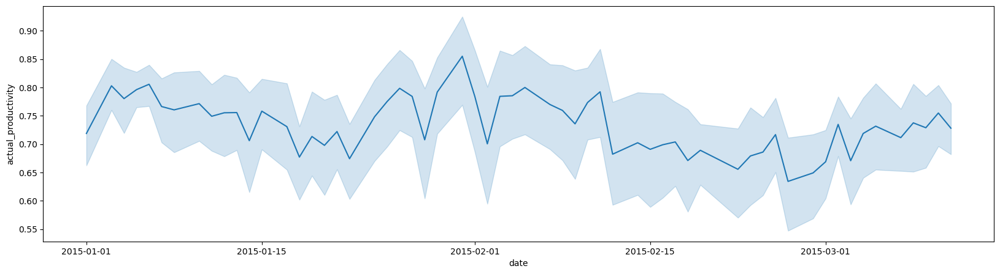

In [8]:
fig, ax = plt.subplots(figsize=(20,5))
sns.lineplot(data=data, x="date", y=target_variable, ax=ax)
plt.show()

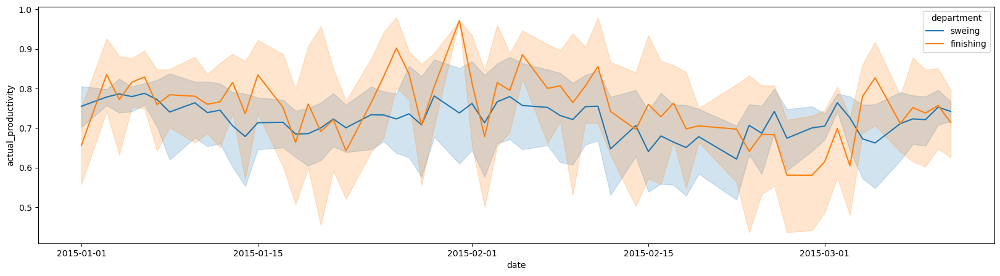

In [9]:
fig, ax = plt.subplots(figsize=(20,5))
sns.lineplot(data=data, x="date", y=target_variable, ax=ax, hue='department')
plt.show()

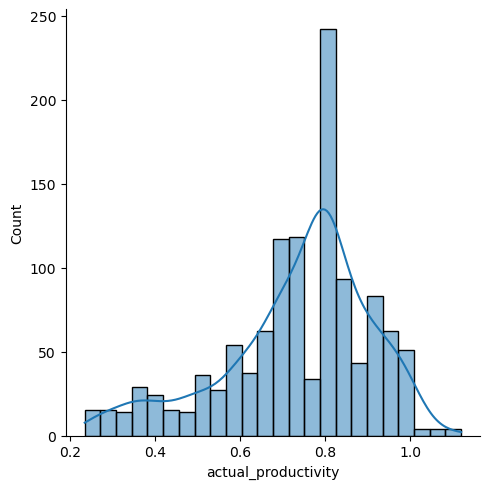

In [10]:
sns.displot(data[target_variable], kde=True)

### Train-test set split

In [11]:
test_size = int(data.shape[0] * 0.2)
train_df = data.iloc[0:-test_size,]
test_df = data.iloc[-test_size:,]

X_train = train_df.drop(columns=[target_variable, 'date'], axis=1)
y_train = train_df[target_variable]
X_test = test_df.drop(columns=[target_variable, 'date'], axis=1)
y_test = test_df[target_variable]

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(958, 16)
(958,)
(239, 16)
(239,)


### Auto Visualization

In [12]:
def display_metrics(index, y_true, y_hat):
    print(f'Mean absolute error is {round(mean_absolute_error(y_true, y_hat), 4)}')
    print(f'Mean absolute percentage error is {round(mean_absolute_percentage_error(y_true, y_hat), 4)}')
    print(f'Mean square error is {round(mean_squared_error(y_true, y_hat), 4)}')
    print(f'Root mean square error is {round(np.sqrt(mean_squared_error(y_true, y_hat)), 4)}')
    print(f'R2 score is {round(r2_score(y_true, y_hat), 4)}')
    print('\n\n')
    fig, ax = plt.subplots(ncols=2, figsize=(20, 5))
    # plot the residual
    sns.distplot(y_true - y_hat, kde=True, ax=ax[0])

    ax[1].plot(index, y_true, color='blue')
    ax[1].plot(index, y_hat, color='red')
    ax[1].set_ylabel('Acutal Productivity')
    ax[1].set_xlabel('Date')
    ax[1].set_title('Predicted vs Actual')


In [15]:
automl = AutoML(
        ml_task='regression',
        mode='Perform',
        eval_metric='mae',
        results_path="productivity-prediction-of-garment-employees"
)
automl.fit(X_train, y_train)

AutoML directory: productivity-prediction-of-garment-employees
The task is regression with evaluation metric mae
AutoML will use algorithms: ['Linear', 'Random Forest', 'LightGBM', 'Xgboost', 'CatBoost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'not_so_random', 'golden_features', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'ensemble']
* Step simple_algorithms will try to check up to 1 model
1_Linear mae 0.097753 trained in 2.78 seconds (1-sample predict time 0.0518 seconds)
* Step default_algorithms will try to check up to 5 models
2_Default_LightGBM mae 0.079 trained in 3.87 seconds (1-sample predict time 0.0306 seconds)
3_Default_Xgboost mae 0.076381 trained in 1.9 seconds (1-sample predict time 0.0314 seconds)
4_Default_CatBoost mae 0.080108 trained in 3.44 seconds (1-sample predict time 0.0243 seconds)
5_Default_NeuralNetwork mae 0.093096 trained in 1.53 seconds (1-samp

AutoML(eval_metric='mae', ml_task='regression', mode='Perform',
       results_path='productivity-prediction-of-garment-employees')

In [16]:
automl.get_leaderboard().sort_values(by=['metric_value']).head(20)

,name,model_type,metric_type,metric_value,train_time,single_prediction_time
63,Ensemble,Ensemble,mae,0.072788,4.06,0.3694
35,27_Xgboost_SelectedFeatures,Xgboost,mae,0.074927,3.48,0.0313
36,28_Xgboost_SelectedFeatures,Xgboost,mae,0.075004,3.15,0.0306
30,3_Default_Xgboost_SelectedFeatures,Xgboost,mae,0.075195,2.97,0.0309
52,44_Xgboost_SelectedFeatures,Xgboost,mae,0.075241,3.76,0.0296
53,45_Xgboost_SelectedFeatures,Xgboost,mae,0.075640,3.56,0.0293
37,29_Xgboost,Xgboost,mae,0.076332,3.41,0.0329
2,3_Default_Xgboost,Xgboost,mae,0.076381,2.23,0.0314
54,46_CatBoost_SelectedFeatures,CatBoost,mae,0.076776,5.49,0.0242
56,48_CatBoost,CatBoost,mae,0.076913,6.30,0.0242


Mean absolute error is 0.0486
Mean absolute percentage error is 0.0897
Mean square error is 0.007
Root mean square error is 0.0834
R2 score is 0.7756





/var/folders/q9/jx0_flz52s507629h4ms15p00000gq/T/ipykernel_26274/2298411725.py:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751



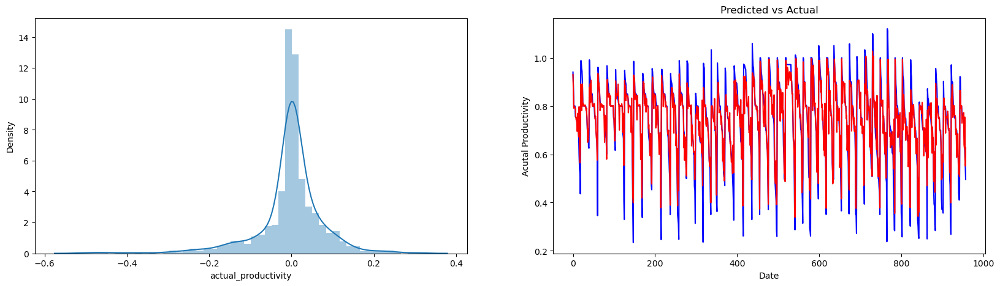

In [17]:
predictions = automl.predict(X_train)
display_metrics(X_train.index, y_train, predictions)

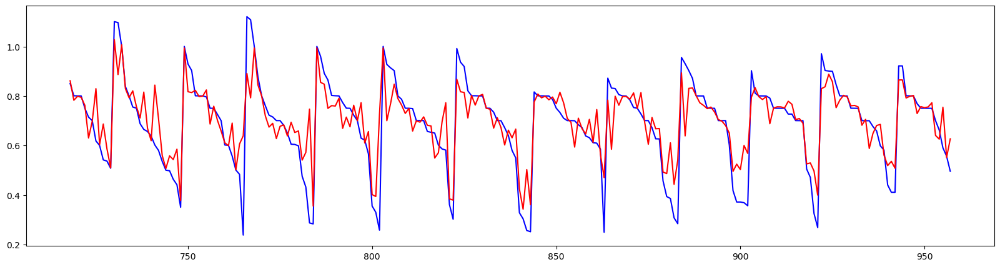

In [18]:
# smaller window of time
fig, ax = plt.subplots(figsize=(20,5))
last_5_days = y_train.iloc[-240:]
ax.plot(last_5_days.index, last_5_days[-240:], color='blue')
ax.plot(last_5_days.index, predictions[-240:], color='red')
plt.show()

### Testing and evaluation

Mean absolute error is 0.0849
Mean absolute percentage error is 0.1635
Mean square error is 0.0165
Root mean square error is 0.1285
R2 score is 0.3866





/var/folders/q9/jx0_flz52s507629h4ms15p00000gq/T/ipykernel_26274/2298411725.py:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751



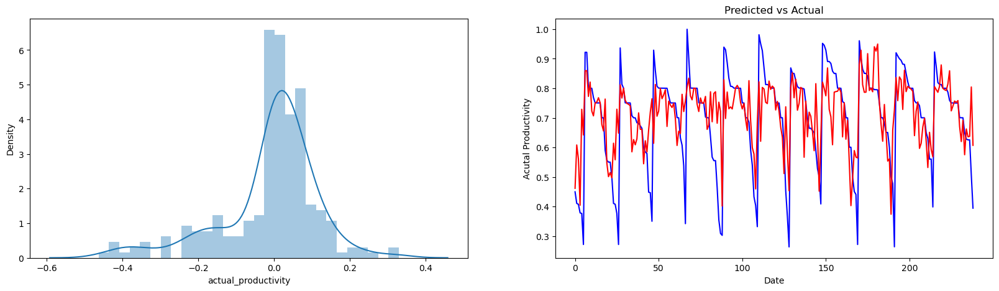

In [19]:
y_hats = automl.predict(X_test)
display_metrics(X_test.index, y_test, y_hats)

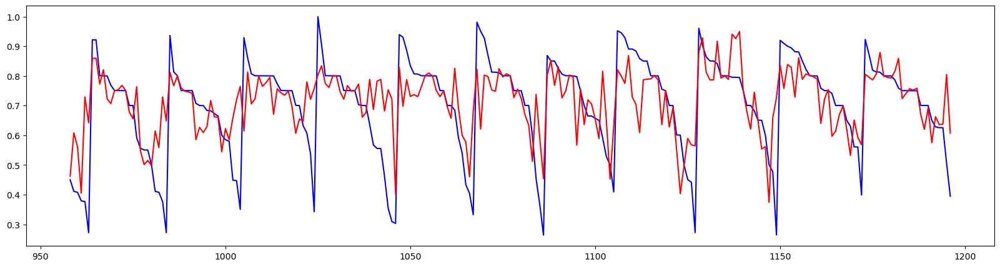

In [20]:
# smaller window of time
fig, ax = plt.subplots(figsize=(20,5))
test_5_days = y_test.iloc[-240:]
ax.plot(test_5_days.index, test_5_days[-240:], color='blue')
ax.plot(test_5_days.index, y_hats[-240:], color='red')
plt.show()

### Report

In [21]:
automl.report()

Best model,name,model_type,metric_type,metric_value,train_time,single_prediction_time
,1_Linear,Linear,mae,0.0977526,3.09,0.0518
,2_Default_LightGBM,LightGBM,mae,0.0790003,4.21,0.0306
,3_Default_Xgboost,Xgboost,mae,0.0763814,2.23,0.0314
,4_Default_CatBoost,CatBoost,mae,0.0801083,3.78,0.0243
,5_Default_NeuralNetwork,Neural Network,mae,0.0930956,1.83,0.0512
,6_Default_RandomForest,Random Forest,mae,0.0885714,4.08,0.1048
,11_LightGBM,LightGBM,mae,0.0843799,2.49,0.0306
,7_Xgboost,Xgboost,mae,0.0798214,2.31,0.0316
,15_CatBoost,CatBoost,mae,0.0807947,5.8,0.0244
,19_RandomForest,Random Forest,mae,0.0888191,4.63,0.1103
